In [2]:
import pandas as pd
import numpy as np
import requests
from io import StringIO
import matplotlib.pyplot as plt
import plotly.express as px
import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap

import geopandas as gpd



In [8]:
# Initialize a map centered around NYC
nyc_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(nyc_map)

# Add stations to the map
for _, row in df_station.iterrows():
    color = 'green' if row['accessible'] == 1 else 'red'  # Green for accessible, red for non-accessible
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=(
            f"Station: {row['stop_name']}<br>"
            f"Borough: {row['borough']}<br>"
            f"Accessible: {'Yes' if row['accessible'] == 1 else 'No'}"
        ),
        icon=folium.Icon(color=color)
    ).add_to(marker_cluster)

# Save the map to an HTML file or display it directly
#nyc_map.save('nyc_station_accessibility.html')
nyc_map


In [11]:
# Initialize a map centered on NYC
overlay_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Add smaller CircleMarkers for each station
for _, row in df_station.iterrows():
    color = 'green' if row['accessible'] == 1 else 'red'  # Green for accessible, Red for non-accessible
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,  # Adjust marker size (smaller size)
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(
            f"<b>Station:</b> {row['stop_name']}<br>"
            f"<b>Borough:</b> {row['borough']}<br>"
            f"<b>Accessible:</b> {'Yes' if row['accessible'] == 1 else 'No'}"
        )
    ).add_to(overlay_map)

# display the map
overlay_map



# Results

In [12]:
# Reading CSV files
output_stations = pd.read_csv('output_stations.csv')
census_nyc = pd.read_csv('census_nyc.csv')
stations_demo = pd.read_csv('stations_demo.csv')

In [17]:
stations_demo["og_ADA"] = stations_demo["ADA"]

In [18]:
output_stations["ADA"] = 3

In [19]:
# Create a mapping dictionary for GTFS Stop IDs to ADA from df2
ada_mapping = dict(zip(output_stations['GTFS Stop IDs'], output_stations['ADA']))

# Replace ADA values in df1 using the mapping, if GTFS Stop ID exists in df2
stations_demo['ADA'] = stations_demo['GTFS Stop IDs'].map(ada_mapping).combine_first(stations_demo['ADA'])

In [20]:
stations_demo

,Unnamed: 0,Complex ID,Is Complex,Number Of Stations In Complex,Stop Name,Display Name,Constituent Station Names,Station IDs,GTFS Stop IDs,Borough,...,Percentage of households with income over $200k,state,county,tract,Total population.1,Median age,Households with children under 6 years,Households with children 6 to 17 years,Workers 16 years and over using public transportation,og_ADA
0,0,1,False,1,Astoria-Ditmars Blvd,Astoria-Ditmars Blvd (N W),Astoria-Ditmars Blvd,1,R01,Q,...,0.901,36,81,11500,2389,34.0,166,0,255,0
1,1,2,False,1,Astoria Blvd,Astoria Blvd (N W),Astoria Blvd,2,R03,Q,...,0.454,36,81,12500,1394,37.8,35,3,153,1
2,2,3,False,1,30 Av,30 Av (N W),30 Av,3,R04,Q,...,2.396,36,81,6300,5712,36.5,86,0,546,0
3,3,4,False,1,Broadway,Broadway (N W),Broadway,4,R05,Q,...,1.354,36,81,5900,3775,32.9,158,25,359,0
4,4,5,False,1,36 Av,36 Av (N W),36 Av,5,R06,Q,...,1.983,36,81,5300,5470,36.5,35,15,702,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
440,440,628,True,4,Fulton St,Fulton St (2 3 4 5 A C J Z),Fulton St,106; 172; 332; 412,229; 418; A38; M22,M,...,3.938,36,61,1502,8623,28.7,118,11,1658,1
441,441,629,True,2,Metropolitan Av/Lorimer St,Metropolitan Av/Lorimer St (G L),Lorimer St; Metropolitan Av,121; 285,G29; L10,Bk,...,2.133,36,47,51300,5570,32.1,68,60,663,1
442,442,630,True,2,Myrtle-Wyckoff Avs,Myrtle-Wyckoff Avs (M L),Myrtle-Wyckoff Avs,112; 128,L17; M08,Bk,...,0.797,36,47,43900,3390,39.1,0,59,146,1
443,443,635,True,2,Whitehall St-South Ferry,Whitehall St-South Ferry (1 R W),South Ferry; Whitehall St-South Ferry,23; 330,142; R27,M,...,0.803,36,61,900,1824,31.5,109,22,375,2


# First vis: Original Stations

In [21]:
# Initialize a map centered on NYC
overlay_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Add smaller CircleMarkers for each station
for _, row in stations_demo.iterrows():
    color = 'green' if row['ADA'] in [1, 2] else 'red'  # Green for accessible, Red for non-accessible
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  # Adjust marker size (smaller size)
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(
            f"<b>Station:</b> {row['Stop Name']}<br>"
        )
    ).add_to(overlay_map)

# Add a custom accessibility information key
accessibility_info_html = """
<div style="
    position: fixed;
    bottom: 40px;
    left: 40px;
    padding: 10px;
    background: white;
    border: 1px solid lightgray;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    font-size: 14px;
    z-index: 1000;
">
    <b>Accessibility Information</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: green; margin-right: 5px;"></div>
        Accessible
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: red; margin-right: 5px;"></div>
        Not Accessible
    </div>
</div>
"""

# Add the accessibility information key to the map
overlay_map.get_root().html.add_child(folium.Element(accessibility_info_html))

# Save the map to an HTML file
overlay_map.save("accessibility_information_map.html")

# Display the map
overlay_map

In [22]:
# Initialize a map centered on NYC
overlay_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Add CircleMarkers for each station
for _, row in stations_demo.iterrows():
    if row['ADA'] in [1, 2]:
        color = 'green'  # Accessible
    elif row['ADA'] == 3:
        color = 'orange'  # Needs improvement
    else:
        color = 'red'  # Not accessible

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  # Adjust marker size
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(
            f"<b>Station:</b> {row['Stop Name']}<br>"
        )
    ).add_to(overlay_map)

# Add a custom accessibility information key
accessibility_info_html = """
<div style="
    position: fixed;
    bottom: 40px;
    left: 40px;
    padding: 10px;
    background: white;
    border: 1px solid lightgray;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    font-size: 14px;
    z-index: 1000;
">
    <b>Accessibility Information</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: green; margin-right: 5px;"></div>
        Accessible
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: orange; margin-right: 5px;"></div>
        Needs Improvement
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: red; margin-right: 5px;"></div>
        Not Accessible
    </div>
</div>
"""

# Add the accessibility information key to the map
overlay_map.get_root().html.add_child(folium.Element(accessibility_info_html))

# Save the map to an HTML file
#overlay_map.save("accessibility_information_map_updated.html")

# Display the map
overlay_map


# Second Vis: Station map with improvement overlaid with accessibility percentage

In [23]:
# Fetch GeoJSON data
geojson_url = 'https://data.cityofnewyork.us/resource/7t3b-ywvw.geojson'
geojson_data = requests.get(geojson_url).json()

# Aggregate data by borough for choropleth
borough_summary = stations_demo.groupby('Borough')['ADA'].apply(lambda x: (x.isin([1, 2]).sum()) / len(x)).reset_index()
borough_summary.columns = ['borough', 'accessibility_rate']
borough_summary['borough'] = borough_summary['borough'].replace({
    'M': 'Manhattan',
    'Bk': 'Brooklyn',
    'Q': 'Queens',
    'Bx': 'Bronx',
    'SI': 'Staten Island'
})

# Initialize the combined map
combined_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

# Add the choropleth layer
folium.Choropleth(
    geo_data=geojson_data,
    data=borough_summary,
    columns=['borough', 'accessibility_rate'],
    key_on='properties.boro_name',  # Adjust based on GeoJSON structure
    fill_color='YlGnBu',  # Yellow to Green-Blue color gradient
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Accessibility Rate by Borough'
).add_to(combined_map)

# Overlay CircleMarkers for station accessibility
for _, row in stations_demo.iterrows():
    if row['ADA'] in [1, 2]:
        color = 'green'  # Accessible
    elif row['ADA'] == 3:
        color = 'orange'  # Needs improvement
    else:
        color = 'red'  # Not accessible

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=4,  # Adjust marker size
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(
            f"<b>Station:</b> {row['Stop Name']}<br>"
            f"<b>ADA:</b> {'Accessible' if row['ADA'] in [1, 2] else 'Needs Improvement' if row['ADA'] == 3 else 'Not Accessible'}"
        )
    ).add_to(combined_map)

# Add a custom legend for the dots
dot_legend_html = """
<div style="
    position: fixed;
    bottom: 40px;
    left: 40px;
    padding: 10px;
    background: white;
    border: 1px solid lightgray;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    font-size: 14px;
    z-index: 1000;
">
    <b>Station Accessibility Key</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: green; margin-right: 5px;"></div>
        Accessible 
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: orange; margin-right: 5px;"></div>
        Needs Improvement 
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: red; margin-right: 5px;"></div>
        Not Accessible 
    </div>
</div>
"""

# Add the legend to the map
combined_map.get_root().html.add_child(folium.Element(dot_legend_html))

# Save the combined map
combined_map.save("combined_map.html")

# Display the map
combined_map

In [25]:
#shapefile_data.head()

In [26]:
#shapefile_data.shape

In [28]:
#census_data.columns

In [29]:
#census_data["tract"]

In [30]:
#shapefile_data["TRACTCE"]

In [31]:
# Convert the 'tract' column to strings and pad with leading zeros to ensure 6 digits
census_data['tract'] = census_data['tract'].astype(str).str.zfill(6)
census_data['county'] = census_data['county'].astype(str).str.zfill(3)

census_data["geo_id"] = census_data['state'].astype(str) + census_data['county'].astype(str) + census_data['tract'].astype(str)

# Check the result
print(census_data['geo_id'].head())

0    36061000100
1    36061000201
2    36061000202
3    36061000500
4    36061000600
Name: geo_id, dtype: object


In [32]:
#census_data.shape

In [33]:
#shapefile_data.shape

In [34]:
# Reading Shapefile
shapefile_data = gpd.read_file('tl_2022_36_tract.shp')
census_data = pd.read_csv('census_nyc.csv')
# Merge census data with shapefile based on geo_id
merged_data = pd.merge(shapefile_data, census_data, left_on='GEOID', right_on='geo_id', how='inner')

In [35]:
merged_data.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,Percentage of households with income over $200k,state,county,tract,Total population.1,Median age,Households with children under 6 years,Households with children 6 to 17 years,Workers 16 years and over using public transportation,geo_id
0,36,081,045000,36081045000,450,Census Tract 450,G5020,S,175572,0,...,678,36,081,045000,2004,32.8,275,4,125,36081045000
1,36,081,045400,36081045400,454,Census Tract 454,G5020,S,230996,0,...,1417,36,081,045400,4793,42.0,119,0,233,36081045400
2,36,081,045500,36081045500,455,Census Tract 455,G5020,S,148238,0,...,3405,36,081,045500,13869,33.2,453,78,355,36081045500
3,36,081,045600,36081045600,456,Census Tract 456,G5020,S,162232,0,...,340,36,081,045600,1244,49.5,0,0,30,36081045600
4,36,081,044602,36081044602,446.02,Census Tract 446.02,G5020,S,170076,0,...,1295,36,081,044602,5210,35.6,15,39,32,36081044602


In [36]:
#merged_data.shape

In [37]:
# Display all columns
pd.set_option('display.max_columns', None)

# Display the DataFrame
merged_data.head()

merged_data = merged_data.dropna(subset=['Total population'])

# Get all columns from 15th to the 2nd last column
cols_to_modify = merged_data.columns[15:30]

# Set values to 0 if they are less than 0
merged_data[cols_to_modify] = merged_data[cols_to_modify].where(merged_data[cols_to_modify] >= 0, 0)



In [38]:
#merged_data.iloc[:5, 15:30]

In [39]:
# Load GeoDataFrame (replace 'your_file_path' with the actual file path)
gdf = merged_data

# Set the CRS (if not already set)
# Replace 'EPSG:XXXX' with the actual CRS of your data (e.g., 'EPSG:4326')
gdf = gdf.set_crs('EPSG:3857')  # Replace XXXX with the CRS your data uses

# Drop rows with missing data in relevant columns
gdf = gdf.dropna(subset=['Total population with a disability'])

# Convert GeoDataFrame to GeoJSON (reproject to WGS 84 for Folium compatibility)
geojson_data = gdf.to_crs(epsg=3857).to_json()

# Create a Folium map
m = folium.Map(location=[40.0, -100.0], zoom_start=4, tiles="CartoDB positron")

# Add choropleth layer
folium.Choropleth(
    geo_data=geojson_data,
    data=gdf,
    columns=['GEOID', 'Total population with a disability'],
    key_on='feature.properties.GEOID',
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Population with a Disability'
).add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

# Save the map to an HTML file (optional)
#m.save('map_population_with_disability.html')

# Display the map
m

# 3rd Vis: Total population with disability

In [40]:
# Set up the GeoDataFrame
gdf = merged_data

# Set the CRS and drop missing data
gdf = gdf.set_crs('EPSG:3857')  # Replace XXXX with the CRS your data uses
gdf = gdf.to_crs(epsg=3857)  # Convert to WGS84 for compatibility
gdf = gdf.dropna(subset=['Total population with a disability', 'geometry'])

# Convert GeoDataFrame to GeoJSON
geojson_data = gdf.to_json()

# Initialize the map
overlay_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11, tiles="CartoDB positron")

# Add the choropleth layer
folium.Choropleth(
    geo_data=geojson_data,
    data=gdf,
    columns=['GEOID', 'Total population with a disability'],
    key_on='feature.properties.GEOID',
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total Population with a Disability'
).add_to(overlay_map)

# Add CircleMarkers for each station
for _, row in stations_demo.iterrows():
    if row['ADA'] in [1, 2]:
        color = 'green'  # Accessible
    elif row['ADA'] == 3:
        color = 'orange'  # Needs improvement
    else:
        color = 'red'  # Not accessible

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  # Adjust marker size
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(f"<b>Station:</b> {row['Stop Name']}<br>")
    ).add_to(overlay_map)

# Add a custom accessibility information key
accessibility_info_html = """
<div style="
    position: fixed;
    bottom: 40px;
    left: 40px;
    padding: 10px;
    background: white;
    border: 1px solid lightgray;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    font-size: 14px;
    z-index: 1000;
">
    <b>Accessibility Information</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: green; margin-right: 5px;"></div>
        Accessible
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: orange; margin-right: 5px;"></div>
        Needs Improvement
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: red; margin-right: 5px;"></div>
        Not Accessible
    </div>
</div>
"""

# Add the legend to the map
overlay_map.get_root().html.add_child(folium.Element(accessibility_info_html))

# Save the map to an HTML file
overlay_map.save("disability_choropleth_with_stations.html")

# Display the map
overlay_map


In [41]:
merged_data['Public transportation (excluding taxicab)_normalized'] = (merged_data['Public transportation (excluding taxicab)'] - merged_data['Public transportation (excluding taxicab)'].mean()) / merged_data['Public transportation (excluding taxicab)'].std()


In [42]:
# Set up the GeoDataFrame
gdf = merged_data

# Set the CRS and drop missing data
gdf = gdf.set_crs('EPSG:3857')  # Replace XXXX with the CRS your data uses
gdf = gdf.to_crs(epsg=3857)  # Convert to WGS84 for compatibility
gdf = gdf.dropna(subset=['Public transportation (excluding taxicab)_normalized', 'geometry'])

# Convert GeoDataFrame to GeoJSON
geojson_data = gdf.to_json()

# Initialize the map
overlay_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11, tiles="CartoDB positron")

# Add the choropleth layer
folium.Choropleth(
    geo_data=geojson_data,
    data=gdf,
    columns=['GEOID', 'Public transportation (excluding taxicab)_normalized'],
    key_on='feature.properties.GEOID',
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Public transportation (excluding taxicab)_normalized'
).add_to(overlay_map)

# Add CircleMarkers for each station
for _, row in stations_demo.iterrows():
    if row['ADA'] in [1, 2]:
        color = 'green'  # Accessible
    elif row['ADA'] == 3:
        color = 'orange'  # Needs improvement
    else:
        color = 'red'  # Not accessible

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  # Adjust marker size
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(f"<b>Station:</b> {row['Stop Name']}<br>")
    ).add_to(overlay_map)

# Add a custom accessibility information key
accessibility_info_html = """
<div style="
    position: fixed;
    bottom: 40px;
    left: 40px;
    padding: 10px;
    background: white;
    border: 1px solid lightgray;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    font-size: 14px;
    z-index: 1000;
">
    <b>Accessibility Information</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: green; margin-right: 5px;"></div>
        Accessible
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: orange; margin-right: 5px;"></div>
        Needs Improvement
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: red; margin-right: 5px;"></div>
        Not Accessible
    </div>
</div>
"""

# Add the legend to the map
overlay_map.get_root().html.add_child(folium.Element(accessibility_info_html))

# Save the map to an HTML file
#overlay_map.save("choropleth_with_stations.html")

# Display the map
overlay_map

# 4th Vis: Age 55 - 59

In [43]:
# Set up the GeoDataFrame
gdf = merged_data

# Set the CRS and drop missing data
gdf = gdf.set_crs('EPSG:3857')  # Replace XXXX with the CRS your data uses
gdf = gdf.to_crs(epsg=3857)  # Convert to WGS84 for compatibility
gdf = gdf.dropna(subset=['Population 55-59', 'geometry'])

# Convert GeoDataFrame to GeoJSON
geojson_data = gdf.to_json()

# Initialize the map
overlay_map = folium.Map(location=[40.7128, -74.0060], zoom_start=11, tiles="CartoDB positron")

# Add the choropleth layer
folium.Choropleth(
    geo_data=geojson_data,
    data=gdf,
    columns=['GEOID', 'Population 55-59'],
    key_on='feature.properties.GEOID',
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Population 55-59'
).add_to(overlay_map)

# Add CircleMarkers for each station
for _, row in stations_demo.iterrows():
    if row['ADA'] in [1, 2]:
        color = 'green'  # Accessible
    elif row['ADA'] == 3:
        color = 'orange'  # Needs improvement
    else:
        color = 'red'  # Not accessible

    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,  # Adjust marker size
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        popup=(f"<b>Station:</b> {row['Stop Name']}<br>")
    ).add_to(overlay_map)

# Add a custom accessibility information key
accessibility_info_html = """
<div style="
    position: fixed;
    bottom: 40px;
    left: 40px;
    padding: 10px;
    background: white;
    border: 1px solid lightgray;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.3);
    font-size: 14px;
    z-index: 1000;
">
    <b>Accessibility Information</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: green; margin-right: 5px;"></div>
        Accessible
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: orange; margin-right: 5px;"></div>
        Needs Improvement
    </div>
    <div style="display: flex; align-items: center; margin-top: 5px;">
        <div style="width: 12px; height: 12px; background: red; margin-right: 5px;"></div>
        Not Accessible
    </div>
</div>
"""

# Add the legend to the map
overlay_map.get_root().html.add_child(folium.Element(accessibility_info_html))

# Save the map to an HTML file
overlay_map.save("age_choropleth_with_stations.html")

# Display the map
overlay_map


In [44]:
np.min(merged_data["Public transportation (excluding taxicab)"])

0.0

(array([1.715e+03, 4.820e+02, 1.080e+02, 1.800e+01, 3.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([ 0.  ,  6.67, 13.34, 20.01, 26.68, 33.35, 40.02, 46.69, 53.36,
        60.03, 66.7 ]),
 <BarContainer object of 10 artists>)

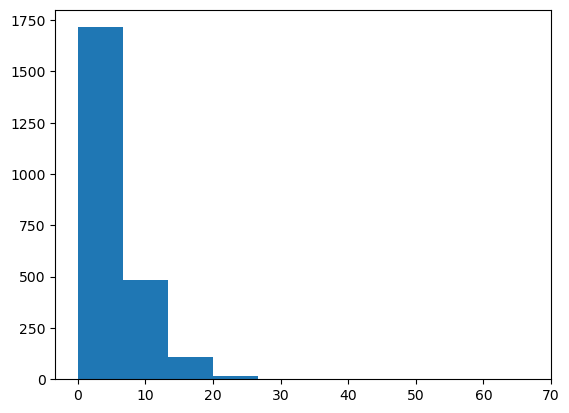

In [45]:
plt.hist(merged_data["Public transportation (excluding taxicab)"])

In [46]:
merged_data["Public transportation (excluding taxicab)"]

0       9.1
1       0.5
2       1.5
3       5.0
4       4.4
       ... 
2322    9.2
2323    2.8
2324    3.4
2325    3.1
2326    5.7
Name: Public transportation (excluding taxicab), Length: 2327, dtype: float64